# Bangalore House Price Prediction


** Importing Libraries **

In [538]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns 
plt.rcParams['figure.figsize'] = (12.0,9.0)

** Importing Dataset **

In [539]:
df = pd.read_csv('Bengaluru_House_Data.csv')
df.head()

,area_type,availability,location,size,society,total_sqft,bath,balcony,price
0,Super built-up Area,19-Dec,Electronic City Phase II,2 BHK,Coomee,1056,2.0,1.0,39.07
1,Plot Area,Ready To Move,Chikka Tirupathi,4 Bedroom,Theanmp,2600,5.0,3.0,120.00
2,Built-up Area,Ready To Move,Uttarahalli,3 BHK,NaN,1440,2.0,3.0,62.00
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3 BHK,Soiewre,1521,3.0,1.0,95.00
4,Super built-up Area,Ready To Move,Kothanur,2 BHK,NaN,1200,2.0,1.0,51.00


In [540]:
df.tail()

,area_type,availability,location,size,society,total_sqft,bath,balcony,price
13315,Built-up Area,Ready To Move,Whitefield,5 Bedroom,ArsiaEx,3453,4.0,0.0,231.0
13316,Super built-up Area,Ready To Move,Richards Town,4 BHK,NaN,3600,5.0,NaN,400.0
13317,Built-up Area,Ready To Move,Raja Rajeshwari Nagar,2 BHK,Mahla T,1141,2.0,1.0,60.0
13318,Super built-up Area,18-Jun,Padmanabhanagar,4 BHK,SollyCl,4689,4.0,1.0,488.0
13319,Super built-up Area,Ready To Move,Doddathoguru,1 BHK,NaN,550,1.0,1.0,17.0


In [541]:
df.shape

(13320, 9)

In [542]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13320 entries, 0 to 13319
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   area_type     13320 non-null  object 
 1   availability  13320 non-null  object 
 2   location      13319 non-null  object 
 3   size          13304 non-null  object 
 4   society       7818 non-null   object 
 5   total_sqft    13320 non-null  object 
 6   bath          13247 non-null  float64
 7   balcony       12711 non-null  float64
 8   price         13320 non-null  float64
dtypes: float64(3), object(6)
memory usage: 936.7+ KB


** Checking the missing values **

In [543]:
df.isnull().sum()

area_type          0
availability       0
location           1
size              16
society         5502
total_sqft         0
bath              73
balcony          609
price              0
dtype: int64

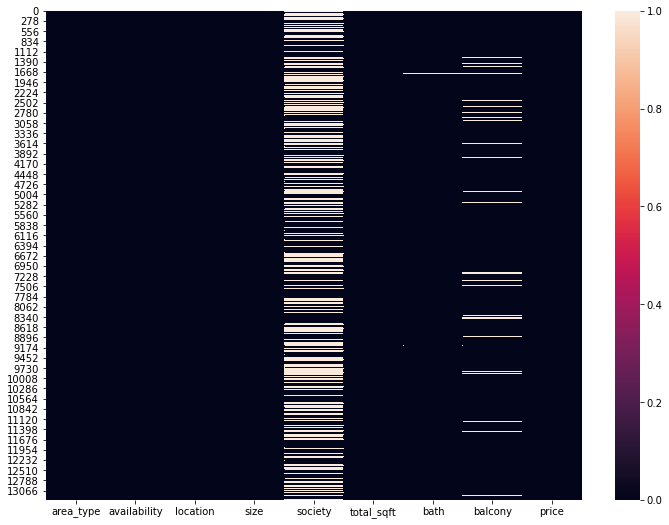

In [544]:
##seeing the missing values in the heatmap
sns.heatmap(df.isnull())

In [545]:
## Seeing the percentage of missing values
missing_val_per = (df.isnull().sum() / df.shape[0] ) * 100
missing_val_per

area_type        0.000000
availability     0.000000
location         0.007508
size             0.120120
society         41.306306
total_sqft       0.000000
bath             0.548048
balcony          4.572072
price            0.000000
dtype: float64

** Droping the columns which has greater than 25% missing values **

In [546]:
drop_columns = missing_val_per[missing_val_per > 25].keys()
drop_columns

Index(['society'], dtype='object')

In [547]:
## Dropping that columns
new_df = df.drop(columns= drop_columns)
new_df

,area_type,availability,location,size,total_sqft,bath,balcony,price
0,Super built-up Area,19-Dec,Electronic City Phase II,2 BHK,1056,2.0,1.0,39.07
1,Plot Area,Ready To Move,Chikka Tirupathi,4 Bedroom,2600,5.0,3.0,120.00
2,Built-up Area,Ready To Move,Uttarahalli,3 BHK,1440,2.0,3.0,62.00
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3 BHK,1521,3.0,1.0,95.00
4,Super built-up Area,Ready To Move,Kothanur,2 BHK,1200,2.0,1.0,51.00
...,...,...,...,...,...,...,...,...
13315,Built-up Area,Ready To Move,Whitefield,5 Bedroom,3453,4.0,0.0,231.00
13316,Super built-up Area,Ready To Move,Richards Town,4 BHK,3600,5.0,NaN,400.00
13317,Built-up Area,Ready To Move,Raja Rajeshwari Nagar,2 BHK,1141,2.0,1.0,60.00
13318,Super built-up Area,18-Jun,Padmanabhanagar,4 BHK,4689,4.0,1.0,488.00


** Converting 'total_sqft' cat feature in numeric **

In [548]:
df['total_sqft'].value_counts()

1200           843
1100           221
1500           205
2400           196
600            180
              ... 
2176             1
1437 - 1629      1
2088             1
3584             1
1076 - 1199      1
Name: total_sqft, Length: 2117, dtype: int64

In [549]:
##Convert it into number by spliting it
total_sqft_int = []
for str_value in df['total_sqft']:
    try:
        total_sqft_int.append(float(str_value))
    except:
        try:
            temp = []
            temp = str_value.split('-')
            total_sqft_int.append( (float(temp[0])) + (float(temp[1])) /2.0  )
        except:
            total_sqft_int.append(np.nan)       


In [550]:
new_df1 = new_df.reset_index(drop=True)

In [551]:
## join new_df and total_srft_int list
new_df2 = new_df1.join(pd.DataFrame({'total_sqft_i':total_sqft_int}))
new_df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13320 entries, 0 to 13319
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   area_type     13320 non-null  object 
 1   availability  13320 non-null  object 
 2   location      13319 non-null  object 
 3   size          13304 non-null  object 
 4   total_sqft    13320 non-null  object 
 5   bath          13247 non-null  float64
 6   balcony       12711 non-null  float64
 7   price         13320 non-null  float64
 8   total_sqft_i  13274 non-null  float64
dtypes: float64(4), object(5)
memory usage: 936.7+ KB


In [552]:
new_df2['total_sqft'] = new_df2['total_sqft_i']

In [553]:
new_df3 = new_df2.drop(columns=['total_sqft_i'] , axis= 1)

In [554]:
new_df3

,area_type,availability,location,size,total_sqft,bath,balcony,price
0,Super built-up Area,19-Dec,Electronic City Phase II,2 BHK,1056.0,2.0,1.0,39.07
1,Plot Area,Ready To Move,Chikka Tirupathi,4 Bedroom,2600.0,5.0,3.0,120.00
2,Built-up Area,Ready To Move,Uttarahalli,3 BHK,1440.0,2.0,3.0,62.00
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3 BHK,1521.0,3.0,1.0,95.00
4,Super built-up Area,Ready To Move,Kothanur,2 BHK,1200.0,2.0,1.0,51.00
...,...,...,...,...,...,...,...,...
13315,Built-up Area,Ready To Move,Whitefield,5 Bedroom,3453.0,4.0,0.0,231.00
13316,Super built-up Area,Ready To Move,Richards Town,4 BHK,3600.0,5.0,NaN,400.00
13317,Built-up Area,Ready To Move,Raja Rajeshwari Nagar,2 BHK,1141.0,2.0,1.0,60.00
13318,Super built-up Area,18-Jun,Padmanabhanagar,4 BHK,4689.0,4.0,1.0,488.00


In [555]:
new_df3.to_csv('a.csv')

## Separating numerical values

In [556]:
new_df_num = new_df3.select_dtypes(include=['int64' , 'float64'])


In [557]:
new_df_num

,total_sqft,bath,balcony,price
0,1056.0,2.0,1.0,39.07
1,2600.0,5.0,3.0,120.00
2,1440.0,2.0,3.0,62.00
3,1521.0,3.0,1.0,95.00
4,1200.0,2.0,1.0,51.00
...,...,...,...,...
13315,3453.0,4.0,0.0,231.00
13316,3600.0,5.0,NaN,400.00
13317,1141.0,2.0,1.0,60.00
13318,4689.0,4.0,1.0,488.00


In [558]:
## Seeing the missing values in numerical features
new_df_num.isnull().sum()

total_sqft     46
bath           73
balcony       609
price           0
dtype: int64

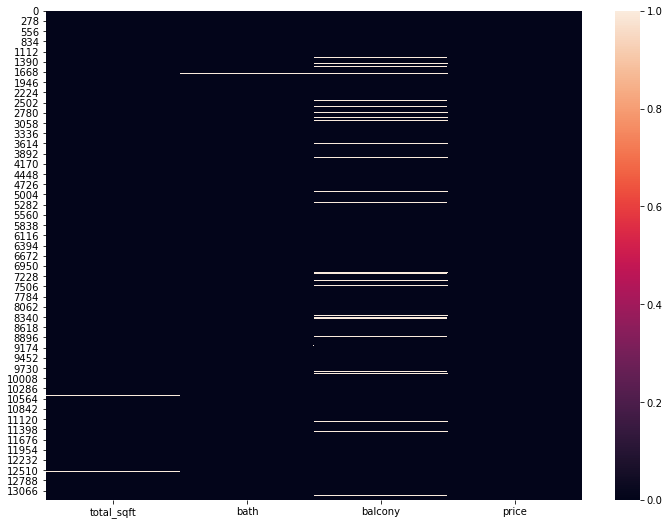

In [559]:
sns.heatmap(new_df_num.isnull())

In [560]:
## Separating the columns of numerical features which has nan values

In [561]:
missing_num_var = [var for var in new_df_num.columns if new_df_num[var].isnull().sum() > 0]
missing_num_var

['total_sqft', 'bath', 'balcony']

** Seeing the distribution of numerical features which contains nan value **

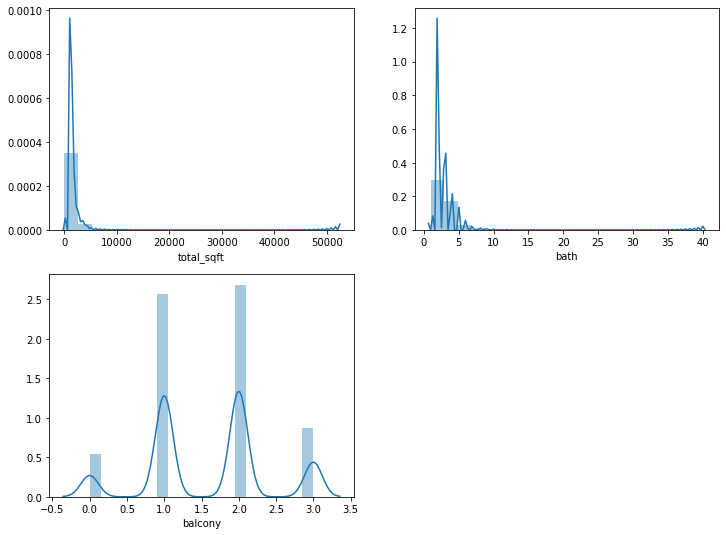

In [562]:
for i, var in enumerate(missing_num_var):
    plt.subplot(2,2, i+1)
    sns.distplot(new_df_num[var] , bins= 20)

In [563]:
## Filling all the missing values with median values
new_df_num_median = new_df_num.fillna(new_df_num.median())

In [564]:
#Checking whether all values are filled or not
new_df_num_median.isnull().sum()

total_sqft    0
bath          0
balcony       0
price         0
dtype: int64

In [565]:
new_df_num_median

,total_sqft,bath,balcony,price
0,1056.0,2.0,1.0,39.07
1,2600.0,5.0,3.0,120.00
2,1440.0,2.0,3.0,62.00
3,1521.0,3.0,1.0,95.00
4,1200.0,2.0,1.0,51.00
...,...,...,...,...
13315,3453.0,4.0,0.0,231.00
13316,3600.0,5.0,2.0,400.00
13317,1141.0,2.0,1.0,60.00
13318,4689.0,4.0,1.0,488.00


**Plotting the original data and cleaned data distribution after mean** 

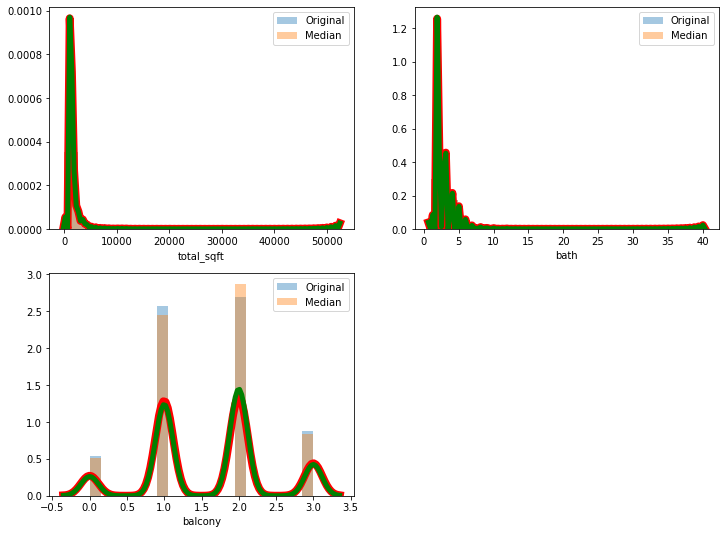

In [566]:
for i, var in enumerate(missing_num_var):
    plt.subplot(2,2, i+1)
    sns.distplot(new_df_num[var] , bins=20 , kde_kws={'linewidth' : 8 , 'color' : 'red'} , label= 'Original')
    sns.distplot(new_df_num_median[var] , bins= 20 , kde_kws={'linewidth' : 5 , 'color' : 'green'} , label= 'Median')
    plt.legend()

## Separating Categorical values

In [567]:
new_df_cat = new_df3.select_dtypes(include = 'object')

In [568]:
new_df_cat

,area_type,availability,location,size
0,Super built-up Area,19-Dec,Electronic City Phase II,2 BHK
1,Plot Area,Ready To Move,Chikka Tirupathi,4 Bedroom
2,Built-up Area,Ready To Move,Uttarahalli,3 BHK
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3 BHK
4,Super built-up Area,Ready To Move,Kothanur,2 BHK
...,...,...,...,...
13315,Built-up Area,Ready To Move,Whitefield,5 Bedroom
13316,Super built-up Area,Ready To Move,Richards Town,4 BHK
13317,Built-up Area,Ready To Move,Raja Rajeshwari Nagar,2 BHK
13318,Super built-up Area,18-Jun,Padmanabhanagar,4 BHK


In [569]:
## Seeing the missing values in categorical features
new_df_cat.isnull().sum()

area_type        0
availability     0
location         1
size            16
dtype: int64

**Seperating the columns of numerical value which has nan values**


In [570]:
missing_cat_var = [var for var in new_df_cat.columns if new_df_cat[var].isnull().sum() > 0]

In [571]:
missing_cat_var

['location', 'size']

In [572]:
## imputing mode values to missing place
new_df_cat['location'].value_counts()

Whitefield                          540
Sarjapur  Road                      399
Electronic City                     302
Kanakpura Road                      273
Thanisandra                         234
                                   ... 
J P Nagar 7th Phase Ramayya City      1
RTO ullalu                            1
B Y Raveshwara Nagar                  1
RMC YARD                              1
Sampige Layout                        1
Name: location, Length: 1305, dtype: int64

In [573]:
## thus here whitefield will be mode value
new_df_cat['location'].mode()

0    Whitefield
dtype: object

In [574]:
# for filling missing values of all the categorical features with mode
for var in missing_cat_var:
    new_df_cat[var].fillna(new_df_cat[var].mode()[0] , inplace= True)
    print(var , ' = ', new_df_cat[var].mode()[0])

location  =  Whitefield
size  =  2 BHK


In [575]:
## checking whether all the missing values is updated or not
new_df_cat.isnull().sum()

area_type       0
availability    0
location        0
size            0
dtype: int64

In [576]:
## Seeing the distribution

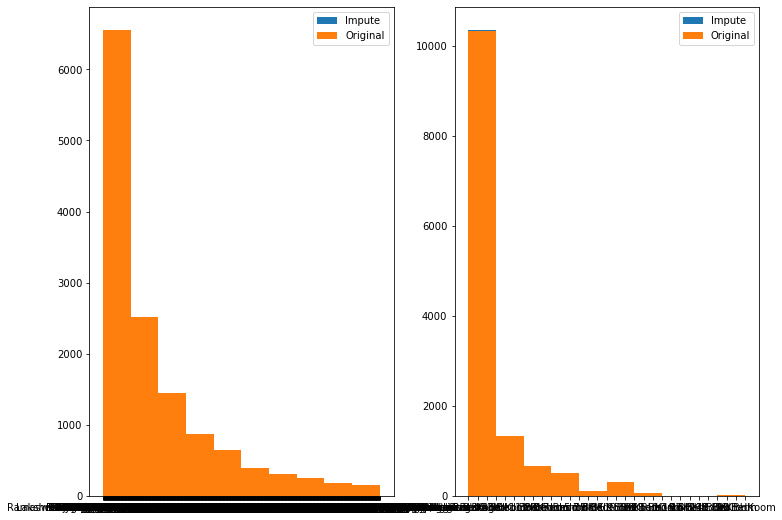

In [577]:
for i, var in enumerate(missing_cat_var):
    plt.subplot(1,2, i+1)
    plt.hist(new_df_cat[var] , label='Impute')
    plt.hist(df[var].dropna() , label='Original')
    plt.legend()

** Converting 'size' feature into numeric **

In [578]:
new_df3['size'].value_counts()

2 BHK         5199
3 BHK         4310
4 Bedroom      826
4 BHK          591
3 Bedroom      547
1 BHK          538
2 Bedroom      329
5 Bedroom      297
6 Bedroom      191
1 Bedroom      105
8 Bedroom       84
7 Bedroom       83
5 BHK           59
9 Bedroom       46
6 BHK           30
7 BHK           17
1 RK            13
10 Bedroom      12
9 BHK            8
8 BHK            5
11 Bedroom       2
10 BHK           2
11 BHK           2
14 BHK           1
27 BHK           1
13 BHK           1
19 BHK           1
12 Bedroom       1
18 Bedroom       1
16 BHK           1
43 Bedroom       1
Name: size, dtype: int64

In [579]:
size_int = []
for str_val in new_df_cat['size']:
    temp=[]
    temp = str_val.split(" ")
    try:
        size_int.append(int(temp[0]))
    except:
        size_int.append(np.nan)

In [580]:
df_c = new_df_cat.reset_index(drop=True)

In [581]:
df_cat = df_c.join(pd.DataFrame({'bhk':size_int}))

In [582]:
df_cat['size'] = df_cat['bhk']

In [583]:
df_cat = df_cat.drop(columns=['bhk'] , axis=1)

In [584]:
df_cat

,area_type,availability,location,size
0,Super built-up Area,19-Dec,Electronic City Phase II,2
1,Plot Area,Ready To Move,Chikka Tirupathi,4
2,Built-up Area,Ready To Move,Uttarahalli,3
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3
4,Super built-up Area,Ready To Move,Kothanur,2
...,...,...,...,...
13315,Built-up Area,Ready To Move,Whitefield,5
13316,Super built-up Area,Ready To Move,Richards Town,4
13317,Built-up Area,Ready To Move,Raja Rajeshwari Nagar,2
13318,Super built-up Area,18-Jun,Padmanabhanagar,4


## Encoding Categorical Variables

In [585]:
df_cat['area_type'].value_counts()

Super built-up  Area    8790
Built-up  Area          2418
Plot  Area              2025
Carpet  Area              87
Name: area_type, dtype: int64

In [586]:
df_cat['availability'].value_counts()

Ready To Move    10581
18-Dec             307
18-May             295
18-Apr             271
18-Aug             200
                 ...  
16-Nov               1
15-Aug               1
17-Jan               1
16-Jul               1
14-Jul               1
Name: availability, Length: 81, dtype: int64

In [587]:
df_cat['location'].value_counts()

Whitefield                          541
Sarjapur  Road                      399
Electronic City                     302
Kanakpura Road                      273
Thanisandra                         234
                                   ... 
J P Nagar 7th Phase Ramayya City      1
RTO ullalu                            1
B Y Raveshwara Nagar                  1
RMC YARD                              1
Sampige Layout                        1
Name: location, Length: 1305, dtype: int64

In [588]:
t_df = df_cat.drop(columns= ['size']) 
t_df

,area_type,availability,location
0,Super built-up Area,19-Dec,Electronic City Phase II
1,Plot Area,Ready To Move,Chikka Tirupathi
2,Built-up Area,Ready To Move,Uttarahalli
3,Super built-up Area,Ready To Move,Lingadheeranahalli
4,Super built-up Area,Ready To Move,Kothanur
...,...,...,...
13315,Built-up Area,Ready To Move,Whitefield
13316,Super built-up Area,Ready To Move,Richards Town
13317,Built-up Area,Ready To Move,Raja Rajeshwari Nagar
13318,Super built-up Area,18-Jun,Padmanabhanagar


In [589]:
dummy_df = pd.get_dummies(t_df)

In [590]:
dummy_df

,area_type_Built-up Area,area_type_Carpet Area,area_type_Plot Area,area_type_Super built-up Area,availability_14-Jul,availability_14-Nov,availability_15-Aug,availability_15-Dec,availability_15-Jun,availability_15-Nov,...,location_rr nagar,location_sankeswari,location_sapthagiri Layout,location_sarjapura main road,location_singapura paradise,location_t.c palya,location_tc.palya,location_vinayakanagar,"location_white field,kadugodi",location_whitefiled
0,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13315,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
13316,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
13317,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
13318,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [591]:
t_df1 = pd.get_dummies(t_df , drop_first= True)

In [592]:
t_df1

,area_type_Carpet Area,area_type_Plot Area,area_type_Super built-up Area,availability_14-Nov,availability_15-Aug,availability_15-Dec,availability_15-Jun,availability_15-Nov,availability_15-Oct,availability_16-Dec,...,location_rr nagar,location_sankeswari,location_sapthagiri Layout,location_sarjapura main road,location_singapura paradise,location_t.c palya,location_tc.palya,location_vinayakanagar,"location_white field,kadugodi",location_whitefiled
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13315,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
13316,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
13317,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
13318,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [593]:
## Joining the final data set

ds1 = pd.concat([t_df1 , df_cat] , axis= 1)

In [594]:
ds1

,area_type_Carpet Area,area_type_Plot Area,area_type_Super built-up Area,availability_14-Nov,availability_15-Aug,availability_15-Dec,availability_15-Jun,availability_15-Nov,availability_15-Oct,availability_16-Dec,...,location_singapura paradise,location_t.c palya,location_tc.palya,location_vinayakanagar,"location_white field,kadugodi",location_whitefiled,area_type,availability,location,size
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,Super built-up Area,19-Dec,Electronic City Phase II,2
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,Plot Area,Ready To Move,Chikka Tirupathi,4
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,Built-up Area,Ready To Move,Uttarahalli,3
3,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,Super built-up Area,Ready To Move,Lingadheeranahalli,3
4,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,Super built-up Area,Ready To Move,Kothanur,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13315,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,Built-up Area,Ready To Move,Whitefield,5
13316,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,Super built-up Area,Ready To Move,Richards Town,4
13317,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,Built-up Area,Ready To Move,Raja Rajeshwari Nagar,2
13318,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,Super built-up Area,18-Jun,Padmanabhanagar,4


In [595]:
del_col = ['area_type', 'availability',	'location']

In [596]:
ds2 = ds1.drop(columns= del_col , axis= 1)

In [597]:
ds2

,area_type_Carpet Area,area_type_Plot Area,area_type_Super built-up Area,availability_14-Nov,availability_15-Aug,availability_15-Dec,availability_15-Jun,availability_15-Nov,availability_15-Oct,availability_16-Dec,...,location_sankeswari,location_sapthagiri Layout,location_sarjapura main road,location_singapura paradise,location_t.c palya,location_tc.palya,location_vinayakanagar,"location_white field,kadugodi",location_whitefiled,size
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3
3,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3
4,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13315,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,5
13316,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
13317,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
13318,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4


In [598]:
final_dataset = pd.concat([ds2 , new_df_num_median] , axis= 1)

In [599]:
final_dataset

,area_type_Carpet Area,area_type_Plot Area,area_type_Super built-up Area,availability_14-Nov,availability_15-Aug,availability_15-Dec,availability_15-Jun,availability_15-Nov,availability_15-Oct,availability_16-Dec,...,location_t.c palya,location_tc.palya,location_vinayakanagar,"location_white field,kadugodi",location_whitefiled,size,total_sqft,bath,balcony,price
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,2,1056.0,2.0,1.0,39.07
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,4,2600.0,5.0,3.0,120.00
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,3,1440.0,2.0,3.0,62.00
3,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,3,1521.0,3.0,1.0,95.00
4,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,2,1200.0,2.0,1.0,51.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13315,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,5,3453.0,4.0,0.0,231.00
13316,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,4,3600.0,5.0,2.0,400.00
13317,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,2,1141.0,2.0,1.0,60.00
13318,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,4,4689.0,4.0,1.0,488.00


In [600]:
final_dataset.isnull().sum().sum()

0

## Implementing Machine Learning Algorithm

### Linear Regression Problem (Supervised Learning)

In [601]:
final_dataset.shape

(13320, 1392)

In [602]:
x = final_dataset.iloc[: , : -1]
y = y = final_dataset.iloc[ : , -1]

In [603]:
x

,area_type_Carpet Area,area_type_Plot Area,area_type_Super built-up Area,availability_14-Nov,availability_15-Aug,availability_15-Dec,availability_15-Jun,availability_15-Nov,availability_15-Oct,availability_16-Dec,...,location_singapura paradise,location_t.c palya,location_tc.palya,location_vinayakanagar,"location_white field,kadugodi",location_whitefiled,size,total_sqft,bath,balcony
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,2,1056.0,2.0,1.0
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,4,2600.0,5.0,3.0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,3,1440.0,2.0,3.0
3,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,3,1521.0,3.0,1.0
4,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,2,1200.0,2.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13315,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,5,3453.0,4.0,0.0
13316,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,4,3600.0,5.0,2.0
13317,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,2,1141.0,2.0,1.0
13318,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,4,4689.0,4.0,1.0


In [604]:
y

0         39.07
1        120.00
2         62.00
3         95.00
4         51.00
          ...  
13315    231.00
13316    400.00
13317     60.00
13318    488.00
13319     17.00
Name: price, Length: 13320, dtype: float64

In [605]:
## Splitting Dataset
from sklearn.model_selection import train_test_split

In [606]:
x_train , x_test , y_train , y_test = train_test_split(x, y, test_size = 0.2 , random_state = 51)

In [607]:
print(" Shape of x_train = ", x_train.shape)
print(" Shape of x_test = ", x_test.shape)
print(" Shape of y_train = ", y_train.shape)
print(" Shape of y_test = ", y_test.shape)

 Shape of x_train =  (10656, 1391)
 Shape of x_test =  (2664, 1391)
 Shape of y_train =  (10656,)
 Shape of y_test =  (2664,)


In [608]:
## Feature Scaling


In [609]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
sc.fit(x_train)
x_train = sc.transform(x_train)
x_test = sc.transform(x_test)

In [610]:
x_train

array([[-0.07711889, -0.42295564,  0.71668428, ..., -0.70867962,
        -1.26124278, -0.74784207],
       [-0.07711889, -0.42295564, -1.39531454, ...,  0.14573052,
        -0.51379808, -1.99125056],
       [-0.07711889, -0.42295564, -1.39531454, ..., -0.25304544,
        -0.51379808, -0.74784207],
       ...,
       [-0.07711889, -0.42295564,  0.71668428, ..., -0.1170467 ,
        -0.51379808,  0.49556643],
       [-0.07711889, -0.42295564,  0.71668428, ...,  1.5595027 ,
         0.98109131,  1.73897493],
       [-0.07711889, -0.42295564, -1.39531454, ..., -0.57344924,
        -0.51379808, -1.99125056]])

In [611]:
x_test

array([[-0.07711889, -0.42295564,  0.71668428, ..., -0.68793405,
        -1.26124278, -0.74784207],
       [-0.07711889, -0.42295564,  0.71668428, ...,  0.29171787,
         0.23364661,  0.49556643],
       [-0.07711889, -0.42295564,  0.71668428, ...,  0.40697103,
         0.23364661,  0.49556643],
       ...,
       [-0.07711889, -0.42295564, -1.39531454, ..., -0.27993784,
        -0.51379808,  1.73897493],
       [-0.07711889, -0.42295564, -1.39531454, ..., -0.28454797,
        -0.51379808, -0.74784207],
       [-0.07711889, -0.42295564,  0.71668428, ..., -0.43437708,
        -0.51379808, -0.74784207]])

In [612]:
## Linear Regression Model Training

In [613]:
from sklearn.linear_model import LinearRegression


In [614]:
lr = LinearRegression() 
lr.fit(x_train, y_train)

LinearRegression()

In [615]:
## Seeing the co-efficient
lr.coef_

array([ 1.19196672, 26.00542673, -1.14241418, ..., 55.75046339,
       35.14825833,  3.66485488])

In [616]:
lr.intercept_

112.5253908596096

In [617]:
## Predict the value of home and test
x_test[0, :]

array([-0.07711889, -0.42295564,  0.71668428, ..., -0.68793405,
       -1.26124278, -0.74784207])

In [618]:
y_pred = lr.predict(x_test)

In [619]:
y_pred

array([ -2.89433713, 110.8213367 , 129.74461926, ...,  77.30307751,
        49.61752992,  40.31239709])

In [620]:
y_test

11791     35.00
3415     131.00
11516    200.00
3147      80.91
3057     200.00
          ...  
12782    137.00
4014      49.00
12879     53.00
10771     34.65
10784     39.77
Name: price, Length: 2664, dtype: float64

In [625]:
from sklearn.metrics import mean_squared_error

In [628]:
metrics.mean_squared_error(y_test, y_pred)

NameError: name 'metrics' is not defined

In [624]:
x_test.shape

(2664, 1391)

In [452]:
y_test.shape

(2664,)